### Import Necessary Libraries

In [3]:
# general
import os

# matrix manipulation
import numpy as np

# dataset handling
import pandas as pd

# sentence clustering model
from sentence_transformers import SentenceTransformer

# sentence clustering utils
from sentence_transformers import util

# model building
import torch

### Load Data

In [4]:
data = pd.read_csv('../data/Sentiment_AIData.csv')
data = data.iloc[:,:2]
data

,Transcription,FinalOutput
0,no no i'm good wish you all the best good day,Positive
1,don't have a capability to add or remove on th...,Negative
2,i need to complain about receiving poor custom...,Negative
3,yes i was hoping to upgrade my data plan and j...,Positive
4,i'd like to complain about an incorrect amount...,Negative
...,...,...
124255,hi i would like to inquire about an issue i ha...,Neutral
124256,thank you very much for calling all state and ...,Positive
124257,sil know i'm i'm sorry i'm sorry since this is...,Negative
124258,regents bank right i mean regions bank right t...,Positive


In [5]:
# data.text = data.text.str.replace('<filler>', '').str.replace('<babble>', '')

In [6]:
sentences = data.Transcription.to_list()

In [7]:
sentences = sentences[:10000]

In [8]:
sentences

["no no i'm good wish you all the best good day",
 "don't have a capability to add or remove on the account unless otherwise the information on your employer's side will be updated and they are the one who's going to coordinate with us to have that removed on the account",
 'i need to complain about receiving poor customer service',
 'yes i was hoping to upgrade my data plan and just wanted some more information on what goes into that',
 "i'd like to complain about an incorrect amount that was charged in my last order",
 "i'm interested in a family package",
 "i understand it's definitely not disgusting to me i actually work at aah at home healthcare for a very long time so i dealt with a lot of patients that had diabetes so i understand that",
 'thank you for helping me understand yeah',
 'yes it is si you can trust the application because all the data that we put there and our encryption has been detailed so no worries on that one for you',
 "my bags checked to even go to the that's 

### Load Model

In [9]:
model = SentenceTransformer('all-MiniLM-L6-v2')

### Clustering

Getting Sentence Embeddings.

In [10]:
sentence_embeddings = model.encode(sentences, batch_size=2048, show_progress_bar=True, convert_to_tensor=True)

Batches:   0%|          | 0/5 [00:00<?, ?it/s]

Clustering the sentences based on embeddings.

In [11]:
clusters = util.community_detection(
  sentence_embeddings,
  min_community_size=1,
  threshold=.6
)

Let's see the clusters.

In [10]:
# help(util)

In [11]:
# ?util.community_detection

In [12]:
num_print_clusters = 10

In [13]:
# clusters_0 = util.community_detection(
#   sentence_embeddings[clusters[0]],
#   min_community_size=1,
#   threshold=.9
# )

In [14]:
# sum([int(len(cluster) == 1) for cluster in clusters_0])

In [15]:
# sentence_embeddings[clusters[0]]

In [12]:
[sentences[sentence_id] for sentence_id in clusters[0]]

['i need to complain about receiving poor customer service',
 "the customer service was terrible and i'd like to file a complaint",
 "i'd like to complain about the quality of customer service i received",
 'that representative gave me bad customer service in the past',
 'my experience with customer service is terrible',
 'i have an issue with customer service',
 'hi i would like to complain about a poor customer service interaction i just had',
 'i would like to file a complaint about customer service',
 'the customer service i received was awful',
 'your customer service is very poor i received very poor customer service this afternoon',
 'your company has offered very poor customer service',
 'i need to place a complaint about an employee',
 'can you help me get a complaint filed for my past customer service call',
 'can i speak to someone about the bad quality of service i received today',
 'i want to complain about a recent customer service call can you please transfer me to your 

In [13]:
# [sentences[sentence_id] for sentence_id in clusters_0[0]]

In [14]:
for i, cluster in enumerate(clusters[:num_print_clusters]):
  
  print(f'*** Cluster {i+1} ***')
  
  for sentence_id in cluster:
    print(sentences[sentence_id], end='\n\n')
  
  print('---------------------')

╭─────────────────────────────── Traceback (most recent call last) ────────────────────────────────╮
│ in <module>:1                                                                                    │
│                                                                                                  │
│ ❱ 1 for i, cluster in enumerate(clusters[:num_print_clusters]):                                  │
│   2                                                                                              │
│   3   print(f'*** Cluster {i+1} ***')                                                            │
│   4                                                                                              │
╰──────────────────────────────────────────────────────────────────────────────────────────────────╯
NameError: name 'num_print_clusters' is not defined

In [15]:
# convert the clusters into a D3.js type tree
tree = {
    'name': len(sentences) + len(clusters), 
    'parent': None,
    'children': list()
    }
for idx, sent_ids in dict(list(enumerate(clusters))).items():
    node = {
        'name': len(sentences) + idx,
        'parent': len(clusters),
        'children': [
            {
                'name': sent_id,
                'parent': idx,
                'children': list()
            } for sent_id in sent_ids
        ]
    }
    tree['children'].append(node)
tree

{'name': 13279,
 'parent': None,
 'children': [{'name': 10000,
   'parent': 3279,
   'children': [{'name': 2, 'parent': 0, 'children': []},
    {'name': 101, 'parent': 0, 'children': []},
    {'name': 118, 'parent': 0, 'children': []},
    {'name': 143, 'parent': 0, 'children': []},
    {'name': 153, 'parent': 0, 'children': []},
    {'name': 159, 'parent': 0, 'children': []},
    {'name': 195, 'parent': 0, 'children': []},
    {'name': 199, 'parent': 0, 'children': []},
    {'name': 234, 'parent': 0, 'children': []},
    {'name': 247, 'parent': 0, 'children': []},
    {'name': 280, 'parent': 0, 'children': []},
    {'name': 282, 'parent': 0, 'children': []},
    {'name': 297, 'parent': 0, 'children': []},
    {'name': 298, 'parent': 0, 'children': []},
    {'name': 304, 'parent': 0, 'children': []},
    {'name': 313, 'parent': 0, 'children': []},
    {'name': 324, 'parent': 0, 'children': []},
    {'name': 325, 'parent': 0, 'children': []},
    {'name': 339, 'parent': 0, 'children': [

In [287]:
# lower the better
len(clusters[0]) - data.iloc[clusters[0],:].FinalOutput.value_counts().max()

1

In [295]:
data.iloc[clusters[1]][data.iloc[clusters[1]].FinalOutput == 'Negative'].Transcription.to_list()

["can you help me get back into my account i'm locked out of my account",
 "for some reason i'm locked out of my account and i need some help getting back in",
 'my account is locked and i need help getting back in',
 "i can't get into my account i believe i'm locked out",
 "i can't get into my account because it's locked",
 'i need help getting into my account i was locked out hi i need help getting back into my account i just locked myself out',
 'i need help getting back into my locked account',
 "i can't get into my account i got locked out",
 'account locked out help me i locked my account',
 "hello i need some help i've locked myself out of my account",
 "i think i'm locked out of my account can you help me i think i'm locked out of my account",
 "i need some help with my account that i'm locked out of",
 "i'm locked out of my account and i need some help getting in",
 "my account is locked and i can't get in",
 'i seem to have locked myself out of my account and need help',
 "ye

In [293]:
data.iloc[clusters[1]][data.iloc[clusters[1]].FinalOutput == 'Neutral'].Transcription.to_list()

['i am needing assistance because i am locked out of my account',
 'i need assistance immediately i am locked out of my account',
 "i've been locked out of my account and need some assistance",
 "i need some assistance because i've been locked out of my account",
 "hi i'm locked out of my account and i'm looking for some assistance",
 'i need assistance to enter my account i am locked out of my account']

In [291]:
data.iloc[clusters[1]]

,Transcription,FinalOutput
104,can you help me get back into my account i'm l...,Negative
998,for some reason i'm locked out of my account a...,Negative
1496,my account is locked and i need help getting b...,Negative
1520,i can't get into my account i believe i'm lock...,Negative
1606,i can't get into my account because it's locked,Negative
...,...,...
9532,i've been locked out of my account i need help...,Negative
9533,i've been locked out of my account and i need ...,Negative
9554,can someone help me due to me being locked out...,Negative
9597,i need assistance to enter my account i am loc...,Neutral


In [289]:
data.iloc[clusters[1]].FinalOutput.value_counts()

FinalOutput
Negative    56
Neutral      6
Name: count, dtype: int64

In [288]:
cluster_quality = list()
for cluster in clusters:
  # print(data.iloc[cluster,:].FinalOutput.value_counts())
  print(data.iloc[cluster,:].FinalOutput.value_counts().max()/len(cluster))
  print()

0.9848484848484849

0.9032258064516129

1.0

1.0

0.75

0.9722222222222222

1.0

1.0

1.0

0.8333333333333334

1.0

0.782608695652174

0.6956521739130435

0.5909090909090909

0.9545454545454546

0.9545454545454546

0.9545454545454546

1.0

0.95

1.0

0.5789473684210527

0.9473684210526315

0.9473684210526315

0.9444444444444444

1.0

0.6470588235294118

0.9375

1.0

1.0

1.0

0.6428571428571429

0.8571428571428571

0.9285714285714286

1.0

0.6923076923076923

0.7692307692307693

0.9230769230769231

1.0

1.0

0.5384615384615384

1.0

1.0

1.0

0.9166666666666666

1.0

1.0

0.8181818181818182

1.0

1.0

1.0

0.4444444444444444

1.0

0.8888888888888888

1.0

1.0

0.875

0.875

1.0

1.0

1.0

1.0

0.625

0.625

1.0

0.7142857142857143

0.7142857142857143

1.0

1.0

1.0

1.0

0.8571428571428571

0.8571428571428571

0.8571428571428571

0.8571428571428571

0.7142857142857143

1.0

0.5

1.0

0.8333333333333334

0.6666666666666666

0.5

1.0

0.6666666666666666

1.0

1.0

1.0

1.0

1.0

1.0

0.8

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0

1.0



In [195]:
data.iloc[:10000,:].FinalOutput.value_counts()

FinalOutput
Positive    4495
Negative    3370
Neutral     2135
Name: count, dtype: int64

In [259]:
data.iloc[[cluster[0] for cluster in clusters if len(cluster) == 1]].Transcription.to_list()

['my order was lost i placed an order and i never received it',
 "i purchased a toaster and didn't notice that it was damaged until i've gotten home how can i file a claim",
 "you all keep giving me bad services i've already talked to six of you all and none of you know how to help me",
 'i apologize for [unintelligible/] for inconvenien how i i i need to i need to know first what what is your customer full name please',
 "my god this is like the most useless phone call i've is there any way that i could possibly talk to your manager because this is just good at this point i'm not getting i have more questions than i have answers right now",
 'great well glad to be of service sir the survey will begin then immediately following this call when you hang up',
 "i'm looking to resolve an issue",
 'i just received my online order and the quality is horrible',
 'well well i apologize for for the inconvenience and i believe as for me the best thing that i could do is to pass you to my manager

In [190]:
[sentences[sentence_id] for sentence_id in clusters[-2002]]

["well i'm interested in law charity"]

In [186]:
len(clusters[-3000])

5

In [175]:
sum([len(cluster) for cluster in clusters])

10000

In [296]:
sum([int(len(cluster)==1) for cluster in clusters])

7560

In [234]:
len(clusters)

5204

In [191]:
sum([int(len(cluster) > 5) for cluster in clusters])

221

In [193]:
sum([len(cluster) for cluster in clusters if len(cluster) >= 3])

6869

In [81]:
from bertopic import BERTopic

In [82]:
# ?BERTopic

In [83]:
# docs = [sentences[sentence_id] for sentence_id in clusters[0]]
docs = sentences

In [84]:
topic_model = BERTopic(verbose=True)

In [85]:
# ?BERTopic

In [86]:
topics, probs = topic_model.fit_transform(docs)

Batches:   0%|          | 0/313 [00:00<?, ?it/s]

2023-06-29 03:47:12,777 - BERTopic - Transformed documents to Embeddings
2023-06-29 03:47:16,639 - BERTopic - Reduced dimensionality
2023-06-29 03:47:16,800 - BERTopic - Clustered reduced embeddings


In [87]:
max(topics)

234

In [88]:
topic_model.visualize_barchart()

In [96]:
sum([int(topic == 119) for topic in topics])

27

In [89]:
sum([int(topic == -1) for topic in topics])

2004

In [90]:
topic_model.visualize_documents(docs)

In [91]:
hierarchical_topics = topic_model.hierarchical_topics(docs)

100%|████████████████████████████████████████| 234/234 [00:00<00:00, 333.36it/s]


In [92]:
topic_model.visualize_hierarchy(hierarchical_topics=hierarchical_topics)

In [125]:
topic_model.get_topic(10)

[('bye', 0.09173009629307641),
 ('day', 0.08812298919241952),
 ('good', 0.044643648168267096),
 ('hope', 0.03934112534479766),
 ('nice', 0.035471614871627526),
 ('too', 0.03257884102156031),
 ('have', 0.031348933958564196),
 ('great', 0.028860016202974563),
 ('wonderful', 0.022858028102775617),
 ('thank', 0.022464632494816825)]

In [97]:
from top2vec import Top2Vec

In [98]:
# ?Top2Vec

In [100]:
model = Top2Vec(
  documents=sentences,
  embedding_model='all-MiniLM-L6-v2',
  speed="deep-learn", 
  workers=8, 
  embedding_batch_size=1024
)

2023-06-29 14:29:56,396 - top2vec - INFO - Pre-processing documents for training
/Users/rishideychowdhury/Desktop/AutoLF/env/lib/python3.8/site-packages/sklearn/feature_extraction/text.py:528: UserWarning:

The parameter 'token_pattern' will not be used since 'tokenizer' is not None'

2023-06-29 14:29:56,690 - top2vec - INFO - Downloading all-MiniLM-L6-v2 model
2023-06-29 14:29:56,914 - top2vec - INFO - Creating joint document/word embedding
2023-06-29 14:30:23,826 - top2vec - INFO - Creating lower dimension embedding of documents
2023-06-29 14:30:27,762 - top2vec - INFO - Finding dense areas of documents
2023-06-29 14:30:27,901 - top2vec - INFO - Finding topics


In [105]:
model.get_num_topics()

146

In [106]:
topic_sizes, topic_nums = model.get_topic_sizes()

In [108]:
pd.DataFrame({
  'Topic Num': topic_nums,
  'Topic Size': topic_sizes
})

,Topic Num,Topic Size
0,0,303
1,1,295
2,2,278
3,3,248
4,4,235
...,...,...
141,141,19
142,142,19
143,143,18
144,144,18


In [117]:
topic_words, word_scores, topic_nums = model.get_topics()

In [122]:
topic_nums

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145])

In [121]:
pd.DataFrame(word_scores)

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
0,0.584137,0.563421,0.413126,0.409819,0.404647,0.398360,0.382957,0.366475,0.360670,0.360616,...,0.271989,0.269543,0.268098,0.262623,0.262501,0.262329,0.259765,0.256213,0.255363,0.253665
1,0.573836,0.420447,0.340782,0.331361,0.325470,0.321978,0.321198,0.320937,0.315834,0.314814,...,0.247649,0.247452,0.246631,0.243098,0.242395,0.242155,0.240529,0.240451,0.240153,0.239404
2,0.673591,0.552435,0.473040,0.435967,0.415776,0.407501,0.406199,0.372859,0.371894,0.366565,...,0.272539,0.272080,0.271948,0.270974,0.268242,0.267978,0.267256,0.266340,0.266276,0.264636
3,0.633201,0.612929,0.590383,0.538754,0.520037,0.508910,0.492920,0.492630,0.489033,0.482046,...,0.358590,0.357976,0.357205,0.355164,0.352999,0.348324,0.346971,0.344854,0.344698,0.343356
4,0.484119,0.410197,0.383094,0.350483,0.343309,0.343208,0.341540,0.335717,0.330139,0.323284,...,0.258861,0.252131,0.251538,0.251469,0.250425,0.247389,0.246831,0.245452,0.244052,0.243168
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
141,0.275678,0.265476,0.250943,0.240496,0.232147,0.215405,0.206159,0.205516,0.205066,0.204836,...,0.174529,0.173972,0.173901,0.173260,0.172740,0.172580,0.171893,0.170316,0.169843,0.169636
142,0.544411,0.409645,0.399287,0.272900,0.267560,0.243007,0.242738,0.235735,0.232722,0.228009,...,0.118276,0.116209,0.115786,0.115267,0.114983,0.114963,0.112732,0.111125,0.110613,0.109990
143,0.630472,0.419055,0.396100,0.373826,0.357307,0.356776,0.331188,0.328781,0.309963,0.295928,...,0.212066,0.211547,0.210591,0.209352,0.208349,0.208136,0.205509,0.204876,0.204276,0.201763
144,0.575552,0.277115,0.264263,0.236977,0.213905,0.193710,0.189718,0.186246,0.182658,0.176540,...,0.112768,0.111024,0.106937,0.106707,0.105521,0.105335,0.103852,0.103815,0.103649,0.103248


In [119]:
pd.DataFrame(np.array(topic_words))

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
0,bye,goodbye,fine,appreciate,happy,alright,end,day,okay,welcome,...,wish,going,over,open,take,wanted,great,today,last,may
1,survey,satisfaction,customer,call,alright,regarding,calling,questions,service,rejected,...,on,number,do,after,will,send,got,request,happy,did
2,email,mail,send,received,alright,address,receive,okay,request,online,...,able,sorry,great,opened,help,order,billing,will,already,open
3,alright,okay,ok,great,fine,sure,yeah,awesome,perfect,that,...,about,interested,any,right,now,need,hey,only,available,got
4,assistance,alright,appreciate,able,sure,helpful,assist,help,worries,fine,...,doing,things,receive,repair,on,yes,other,great,your,trying
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
141,ma,appreciate,customer,call,calling,reception,afternoon,received,calls,us,...,mail,may,full,sorry,bye,gonna,delivery,survey,awesome,great
142,billing,address,paperless,bank,payments,mail,payment,account,receipt,transaction,...,on,complaint,thousand,customer,internet,well,purchased,delivery,first,store
143,hacked,account,password,stolen,store,purchased,locked,purchase,customer,transaction,...,open,possible,didn,problem,can,use,new,after,getting,complaint
144,insurance,coverage,policy,overseas,billing,deductible,country,foreign,plans,discount,...,price,worries,will,service,email,may,worry,experience,transfer,hope


In [126]:
topic_words[0]

array(['bye', 'goodbye', 'fine', 'appreciate', 'happy', 'alright', 'end',
       'day', 'okay', 'welcome', 'you', 'hey', 'thanks', 'all', 'hello',
       'received', 'go', 'ok', 'stay', 'sure', 'outstanding', 'opened',
       'rest', 'thank', 'afternoon', 'morning', 'hi', 'full', 'sorry',
       'your', 'care', 'sent', 'done', 'apologize', 'wonderful', 'able',
       'glad', 'talk', 'doing', 'worries', 'wish', 'going', 'over',
       'open', 'take', 'wanted', 'great', 'today', 'last', 'may'],
      dtype='<U14')

In [127]:
topic_words, word_scores, topic_nums = model.get_topics(reduced=True)

ValueError: Hierarchical topic reduction has not been performed.

In [132]:
topic_words, word_scores, topic_scores, topic_nums = model.search_topics(keywords=['complaint'], num_topics=5)

In [134]:
topic_nums

array([107,  12,  36,  95,  59])

### Agglomerative Clustering

In [55]:
from sklearn.cluster import AgglomerativeClustering

In [56]:
# Normalize the embeddings to unit length
corpus_embeddings = sentence_embeddings /  np.linalg.norm(sentence_embeddings, axis=1, keepdims=True)

In [78]:
?AgglomerativeClustering

In [57]:
clustering_model = AgglomerativeClustering(n_clusters=None, metric='cosine', linkage='average', distance_threshold=0.5)
clustering_model.fit(corpus_embeddings)
cluster_assignment = clustering_model.labels_

In [91]:
cluster_assignment.shape

(10000,)

In [92]:
cluster_assignment.max()

1833

In [93]:
clustered_sentences = {}
for sentence_id, cluster_id in enumerate(cluster_assignment):
    if cluster_id not in clustered_sentences:
        clustered_sentences[cluster_id] = []

    clustered_sentences[cluster_id].append(sentences[sentence_id])

for i, cluster in clustered_sentences.items():
    print(f"*** Cluster {i} ***")
    for sentence in cluster:
      print(sentence)
      print()
    print()
    print("---------------------")

*** Cluster 71 ***
no no i'm good wish you all the best good day

i don't think i'll be doing that today but have a nice day

alright sounds good wish you a good day

yeah no i don't think i'll be doing that have have a good day bob


---------------------
*** Cluster 961 ***
don't have a capability to add or remove on the account unless otherwise the information on your employer's side will be updated and they are the one who's going to coordinate with us to have that removed on the account


---------------------
*** Cluster 154 ***
i need to complain about receiving poor customer service

i apologize for [unintelligible/] for inconvenien how i i i need to i need to know first what what is your customer full name please

the customer service was terrible and i'd like to file a complaint

i'd like to complain about the quality of customer service i received

that representative gave me bad customer service in the past

my experience with customer service is terrible

i have an issue w

In [94]:
len(clustered_sentences[349])

8

In [95]:
from scipy.cluster.hierarchy import dendrogram
import matplotlib.pyplot as plt

In [96]:
def plot_dendrogram(model, **kwargs):
  # Create linkage matrix and then plot the dendrogram

  # create the counts of samples under each node
  counts = np.zeros(model.children_.shape[0])
  n_samples = len(model.labels_)
  for i, merge in enumerate(model.children_):
      current_count = 0
      for child_idx in merge:
          if child_idx < n_samples:
              current_count += 1  # leaf node
          else:
              current_count += counts[child_idx - n_samples]
      counts[i] = current_count

  linkage_matrix = np.column_stack(
      [model.children_, model.distances_, counts]
  ).astype(float)

  # Plot the corresponding dendrogram
  dendrogram(linkage_matrix, **kwargs)

In [58]:
def create_linkage_matrix(model):
  # Create linkage matrix and then plot the dendrogram

  # create the counts of samples under each node
  counts = np.zeros(model.children_.shape[0])
  n_samples = len(model.labels_)
  for i, merge in enumerate(model.children_):
      current_count = 0
      for child_idx in merge:
          if child_idx < n_samples:
              current_count += 1  # leaf node
          else:
              current_count += counts[child_idx - n_samples]
      counts[i] = current_count

  linkage_matrix = np.column_stack(
      [model.children_, model.distances_, counts]
  ).astype(float)
  
  return linkage_matrix

In [59]:
clustering_model.children_

array([[ 2618,  5263],
       [ 5881,  6227],
       [ 1646,  8621],
       ...,
       [19993, 19995],
       [19994, 19996],
       [19194, 19997]])

In [60]:
linku = create_linkage_matrix(clustering_model)

In [61]:
pd.DataFrame(linku)

,0,1,2,3
0,2618.0,5263.0,0.000613,2.0
1,5881.0,6227.0,0.001253,2.0
2,1646.0,8621.0,0.002077,2.0
3,1763.0,7309.0,0.002201,2.0
4,6529.0,9575.0,0.002599,2.0
...,...,...,...,...
9994,2345.0,19989.0,0.932933,26.0
9995,19984.0,19990.0,0.935607,9739.0
9996,19993.0,19995.0,0.939299,9972.0
9997,19994.0,19996.0,0.944735,9998.0


In [62]:
def create_tree(linked):
    # inner func to recurvise-ly walk the linkage matrix
    def recurTree(tree):
        k = tree['name']
        ## no children for this node
        if k not in inter:
            return
        for n in inter[k]:
            ## build child nodes
            node = {
                "name": n,
                "parent": k,
                "children": []
            }
            # add to children
            tree['children'].append(node)
            # next recursion
            recurTree(node)      
    
    num_rows, _ = linked.shape
    inter = {}
    i = 0
    # loop linked matrix convert to dictionary
    for row in linked:
        i += 1
        inter[float(i + num_rows)] = [row[0],row[1]]

    # start tree data structure
    tree = {
        "name": float(i + num_rows),
        "parent": None,
        "children": []
    }
    # start recursion
    recurTree(tree);
    return tree

In [63]:
tree = create_tree(linku)

In [64]:
tree

{'name': 19998.0,
 'parent': None,
 'children': [{'name': 19194.0,
   'parent': 19998.0,
   'children': [{'name': 4518.0, 'parent': 19194.0, 'children': []},
    {'name': 5323.0, 'parent': 19194.0, 'children': []}]},
  {'name': 19997.0,
   'parent': 19998.0,
   'children': [{'name': 19994.0,
     'parent': 19997.0,
     'children': [{'name': 2345.0, 'parent': 19994.0, 'children': []},
      {'name': 19989.0,
       'parent': 19994.0,
       'children': [{'name': 6873.0, 'parent': 19989.0, 'children': []},
        {'name': 19981.0,
         'parent': 19989.0,
         'children': [{'name': 19344.0,
           'parent': 19981.0,
           'children': [{'name': 1444.0, 'parent': 19344.0, 'children': []},
            {'name': 9631.0, 'parent': 19344.0, 'children': []}]},
          {'name': 19907.0,
           'parent': 19981.0,
           'children': [{'name': 19488.0,
             'parent': 19907.0,
             'children': [{'name': 17987.0,
               'parent': 19488.0,
           

In [32]:
'#'*3

'###'

In [55]:
tree['name']

19998.0

In [61]:
sentences = np.array(sentences)

In [63]:
cluster_assignment.max()

4624

In [21]:
def tree_to_markmap(tree, num_levels):
  def recurMarkMap(node, level):
    if level > num_levels:
      return
    if node['name'] >= len(sentences):
      print('\t'*level, '-', node['name'])
    else:
      print('\t'*level, '-', sentences[int(node['name'])])
    if len(node['children']):
      for children in node['children']:
        recurMarkMap(children, level+1)
  recurMarkMap(tree, 0)

In [59]:
tree_to_markmap(tree, 100)

 - 19998.0
	 - 19194.0
		 - ok sir so for the "xbox" it has better ergonomics on its controller but the "sony" "psp" has a better graphics all in all
		 - i'm doing good too i'm looking for information about video game video game consoles
	 - 19997.0
		 - 19994.0
			 - okay and are there any limitations or exclusions on compression stockings or any lower aah compression garments low extremity compression garments
			 - 19989.0
				 - it is collapsible but i don't think it's collapsible enough to fit any of our suitcase
				 - 19981.0
					 - 19344.0
						 - does it have any measurement issues or just i need to keep the thing okay
						 - so maximum accepted dimensions it's forty inches in height
					 - 19907.0
						 - 19488.0
							 - 17987.0
								 - it's fine ma'am if it's already been opened but i need to ask you to reseal it first with some tape before sending it back to our offices
								 - will be safe sealed so you don't have to worry on it
							 - 19336.0
								 - 

In [68]:
sentences[cluster_assignment == cluster_assignment[5000]]

array(['i have a complaint about an item that i purchased when i open the box and home i saw that the item was damaged',
       'i purchased an item and i took it home and i opened it up and it was damaged can you help me i purchased an item and opened it when i got home it was already damaged i have a damaged item i purchased it and brought it home and when i opened it up at home it was aleady damaged',
       'i need to speak with someone about a damaged item that i bought and opened in my home',
       'i purchased something at your store and when i got it home it was damaged i opened an item at home and it was damaged i purchased it at your store',
       'i purchase something open it at home and then realized it was damaged',
       'i would like to report that i received the damaged item that i purchased once i opened it when i got home',
       "i purchased an item in the store and opened it up at home and noticed that it was damaged i'd like to file a complaint",
       'i need

In [66]:
cluster_assignment[5000]

51

In [20]:
def tree_to_markmap(tree, num_levels):
  def recurMarkMap(node, level):
    if level > num_levels:
      return
    if node['name'] >= len(sentences):
      print('\t'*level, '-', node['name'])
    else:
      cluster_sentences = sentences[cluster_assignment == cluster_assignment[int(node['name'])]]
      for sentence in cluster_sentences:
        print('\t'*level, '-', sentence)
      return
    if len(node['children']):
      for children in node['children']:
        recurMarkMap(children, level+1)
  recurMarkMap(tree, 0)

In [106]:
tree_to_markmap(tree, 20)

 - 19998.0
	 - 19194.0
		 - ok sir so for the "xbox" it has better ergonomics on its controller but the "sony" "psp" has a better graphics all in all
		 - i'm doing good too i'm looking for information about video game video game consoles
	 - 19997.0
		 - 19994.0
			 - okay and are there any limitations or exclusions on compression stockings or any lower aah compression garments low extremity compression garments
			 - 19989.0
				 - it is collapsible but i don't think it's collapsible enough to fit any of our suitcase
				 - 19981.0
					 - 19344.0
						 - does it have any measurement issues or just i need to keep the thing okay
						 - so maximum accepted dimensions it's forty inches in height
					 - 19907.0
						 - 19488.0
							 - 17987.0
								 - it's fine ma'am if it's already been opened but i need to ask you to reseal it first with some tape before sending it back to our offices
								 - will be safe sealed so you don't have to worry on it
								 - it's fine ma'am if

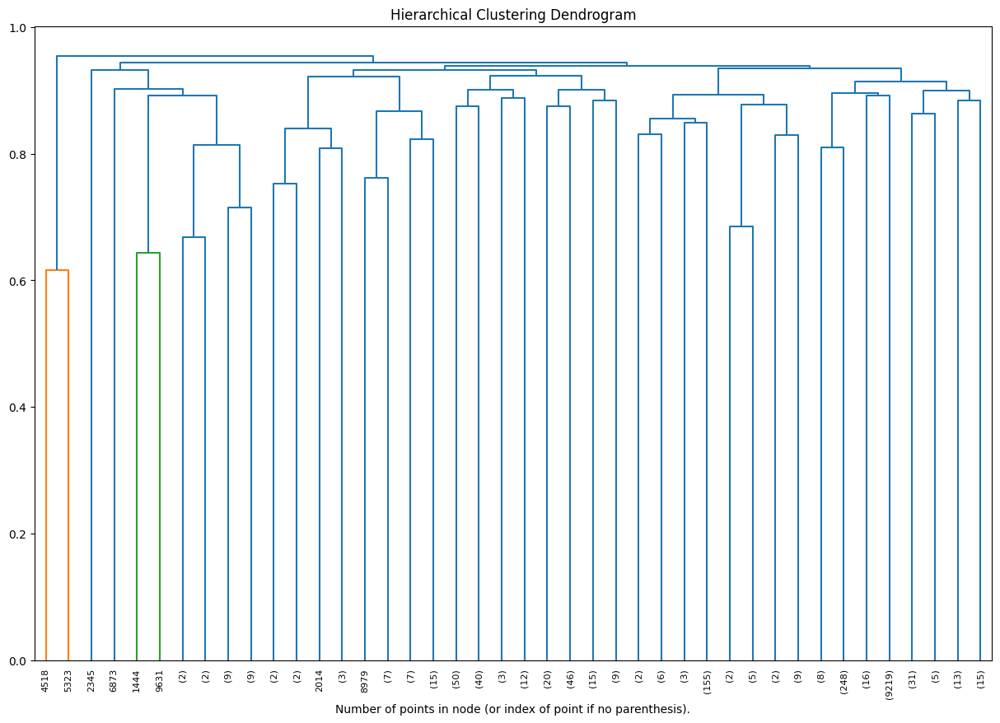

In [327]:
plt.figure(figsize=(15,10))
plt.title("Hierarchical Clustering Dendrogram")
# plot the top three levels of the dendrogram
plot_dendrogram(clustering_model, truncate_mode="level", p=6)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

In [1]:
from streamlit_markmap import markmap

In [2]:
?markmap

In [21]:
def tree_to_markmap(tree, num_levels):

    def recurMarkMap(node, level):
        markmap_text = ''
        if level > num_levels:
            return
        if node['name'] >= len(sentences):
            markmap_text += '\t'*level + f"- {node['name']}\n"
        else:
            markmap_text += '\t'*level + f"- {sentences[int(node['name'])]}\n"
        if len(node['children']):
            for children in node['children']:
                markmap_text += recurMarkMap(children, level+1)
        return markmap_text

    # recursively create the tree
    markmap_text = recurMarkMap(tree, 0)

    return markmap_text

In [22]:
print(tree_to_markmap(tree, 20))

- 13279
	- 10000
		- i need to complain about receiving poor customer service
		- the customer service was terrible and i'd like to file a complaint
		- i'd like to complain about the quality of customer service i received
		- that representative gave me bad customer service in the past
		- my experience with customer service is terrible
		- i have an issue with customer service
		- hi i would like to complain about a poor customer service interaction i just had
		- i would like to file a complaint about customer service
		- the customer service i received was awful
		- your customer service is very poor i received very poor customer service this afternoon
		- your company has offered very poor customer service
		- i need to place a complaint about an employee
		- can you help me get a complaint filed for my past customer service call
		- can i speak to someone about the bad quality of service i received today
		- i want to complain about a recent customer service call can you please t

In [24]:
print(tree_to_markmap(tree, 20))

- 13279
	- 10000
		- i need to complain about receiving poor customer service
		- the customer service was terrible and i'd like to file a complaint
		- i'd like to complain about the quality of customer service i received
		- that representative gave me bad customer service in the past
		- my experience with customer service is terrible
		- i have an issue with customer service
		- hi i would like to complain about a poor customer service interaction i just had
		- i would like to file a complaint about customer service
		- the customer service i received was awful
		- your customer service is very poor i received very poor customer service this afternoon
		- your company has offered very poor customer service
		- i need to place a complaint about an employee
		- can you help me get a complaint filed for my past customer service call
		- can i speak to someone about the bad quality of service i received today
		- i want to complain about a recent customer service call can you please t

In [25]:
import pandas as pd
import streamlit as st
from st_aggrid import JsCode, AgGrid, GridOptionsBuilder, GridUpdateMode

In [ ]:


df=pd.DataFrame([{"orgHierarchy": 'A', "jobTitle": "CEO", "employmentType": "Permanent" },
    { "orgHierarchy": 'A/B', "jobTitle": "VP", "employmentType": "Permanent" }])
st.write(df)
gb = GridOptionsBuilder.from_dataframe(df)
gridOptions = gb.build()


gridOptions["columnDefs"]= [
    { "field": 'jobTitle' },
    { "field": 'employmentType' },
]
gridOptions["defaultColDef"]={
      "flex": 1,
    },
gridOptions["autoGroupColumnDef"]= {
    "headerName": 'Organisation Hierarchy',
    "minWidth": 300,
    "cellRendererParams": {
      "suppressCount": True,
    },
  },
gridOptions["treeData"]=True
gridOptions["animateRows"]=True
gridOptions["groupDefaultExpanded"]= -1
gridOptions["getDataPath"]=JsCode(""" function(data){
    return data.orgHierarchy.split("/");
  }""").js_code

r = AgGrid(
    df,
    gridOptions=gridOptions,
    height=500,
    allow_unsafe_jscode=True,
    enable_enterprise_modules=True,
    filter=True,
    update_mode=GridUpdateMode.SELECTION_CHANGED,
    theme="material",
    tree_data=True
)

In [27]:
tree

{'name': 13279,
 'parent': None,
 'children': [{'name': 10000,
   'parent': 3279,
   'children': [{'name': 2, 'parent': 0, 'children': []},
    {'name': 101, 'parent': 0, 'children': []},
    {'name': 118, 'parent': 0, 'children': []},
    {'name': 143, 'parent': 0, 'children': []},
    {'name': 153, 'parent': 0, 'children': []},
    {'name': 159, 'parent': 0, 'children': []},
    {'name': 195, 'parent': 0, 'children': []},
    {'name': 199, 'parent': 0, 'children': []},
    {'name': 234, 'parent': 0, 'children': []},
    {'name': 247, 'parent': 0, 'children': []},
    {'name': 280, 'parent': 0, 'children': []},
    {'name': 282, 'parent': 0, 'children': []},
    {'name': 297, 'parent': 0, 'children': []},
    {'name': 298, 'parent': 0, 'children': []},
    {'name': 304, 'parent': 0, 'children': []},
    {'name': 313, 'parent': 0, 'children': []},
    {'name': 324, 'parent': 0, 'children': []},
    {'name': 325, 'parent': 0, 'children': []},
    {'name': 339, 'parent': 0, 'children': [

In [88]:
def tree_to_dataframe(tree, num_levels, sentences):
    '''
    converts D3.js type tree to DataFrame.
    :tree: the nested dictionary which is in the form of D3.js
    :num_levels: how many levels of the tree to print
    :sentences: the list of sentences whose index is refered in the leaves of the `tree`
    '''
    def recurNestDataFrame(node, level):

        # maintain the hierarchy
        hierarchy = str(node['name'])
        
        # create the tree dataframe
        dataframe = pd.DataFrame({
                'Hierarchy': [hierarchy], 'Sentence': ['']
            })
        
        if level > num_levels:
            return ''
        if node['name'] < len(sentences):
            dataframe['Sentence'] = sentences[int(node['name'])]
            
        if len(node['children']):
            for children in node['children']:
                child_dataframe = recurNestDataFrame(children, level+1)
                child_dataframe.Hierarchy = child_dataframe.Hierarchy.apply(
                    lambda x: f'{hierarchy}/{x}' # if x.split('/')[0] != str(node['name']) else hierarchy
                    )
                dataframe = pd.concat([dataframe, child_dataframe])
        return dataframe

    # recursively create the tree
    dataframe = recurNestDataFrame(tree, 0)

    return dataframe

In [89]:
tree

{'name': 19998.0,
 'parent': None,
 'children': [{'name': 19194.0,
   'parent': 19998.0,
   'children': [{'name': 4518.0, 'parent': 19194.0, 'children': []},
    {'name': 5323.0, 'parent': 19194.0, 'children': []}]},
  {'name': 19997.0,
   'parent': 19998.0,
   'children': [{'name': 19994.0,
     'parent': 19997.0,
     'children': [{'name': 2345.0, 'parent': 19994.0, 'children': []},
      {'name': 19989.0,
       'parent': 19994.0,
       'children': [{'name': 6873.0, 'parent': 19989.0, 'children': []},
        {'name': 19981.0,
         'parent': 19989.0,
         'children': [{'name': 19344.0,
           'parent': 19981.0,
           'children': [{'name': 1444.0, 'parent': 19344.0, 'children': []},
            {'name': 9631.0, 'parent': 19344.0, 'children': []}]},
          {'name': 19907.0,
           'parent': 19981.0,
           'children': [{'name': 19488.0,
             'parent': 19907.0,
             'children': [{'name': 17987.0,
               'parent': 19488.0,
           

In [90]:
tree_to_dataframe(tree, 200, sentences)

,Hierarchy,Sentence
0,19998.0,
0,19998.0/19194.0,
0,19998.0/19194.0/4518.0,"ok sir so for the ""xbox"" it has better ergonom..."
0,19998.0/19194.0/5323.0,i'm doing good too i'm looking for information...
0,19998.0/19997.0,
...,...,...
0,19998.0/19997.0/19996.0/19995.0/19990.0/19986....,
0,19998.0/19997.0/19996.0/19995.0/19990.0/19986....,yeah the change can be made immediately actual...
0,19998.0/19997.0/19996.0/19995.0/19990.0/19986....,
0,19998.0/19997.0/19996.0/19995.0/19990.0/19986....,yeah temporary change is adequate right


In [46]:
pd.DataFrame({
    'lala': ['lo']
}).lala.apply(lambda x: f'lele/{x}')

0    lele/lo
Name: lala, dtype: object